# Squential Event Feature Extraction

Example:
- ``


### Import Libraries

In [1]:
# Parsing and wrangling
import pandas as pd
import numpy as np
from numpy import array
from numpy import hstack
import regex as re
import time

from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score
from sklearn.model_selection import StratifiedShuffleSplit
import tensorflow as tf
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader, Dataset, TensorDataset

## Creating enhanced sequential features
## *Car Hijacking Feature Engineering*

- Group by the CAN ID 
- Compute time differences between messages
- Convert unique messages to message types
- Create event sequences with time difference feature

In [2]:
## import raw data
path = '../All-Data/HK-CarHackingDataset/'

attack_free1 = pd.Series(pd.read_csv(path + 'Attack_free_dataset.txt', header=None)[0])
attack_free2 = pd.Series(pd.read_csv(path + 'normal_run_data.txt', header=None)[0])

dos_raw = pd.read_csv(path + 'DoS_dataset.csv', names = [0,1,2,3,4,5,6,7,8,9,10,11], keep_default_na = False, header=None)
fuzzy_raw = pd.read_csv(path + 'Fuzzy_dataset.csv', names = [0,1,2,3,4,5,6,7,8,9,10,11], keep_default_na = False, header=None)
gear_raw = pd.read_csv(path + 'gear_dataset.csv', names = [0,1,2,3,4,5,6,7,8,9,10,11], keep_default_na = False, header=None)
rpm_raw = pd.read_csv(path + 'RPM_dataset.csv', names = [0,1,2,3,4,5,6,7,8,9,10,11], keep_default_na = False, header=None)


## Cleaning the Anomaly Free .txt Dataset

In [3]:

# Cleans normal.txt data and prepares a normal df feature frame
# takes text data as series and outputs a dataframe specific to the car hijack dataset without anomalies
def assemble_normal_df_from_txt(text_series):
    # extract numeric values in each string (row) by leaving out the column names
    print('Starting regex parsing')
    all_columns = text_series.str.findall(r'(?<![Timestamp:])[\d\.a-z]*[^A-Z\:\s*]') 
    
    # keep only rows where at least 4 columns of data exists
    all_columns = all_columns[all_columns.str.len() >= 4]

    # extract columns from a list of lists at given index
    def col_extractor(list_of_lists, col_idx, concat = False):
        # joins all list values after given col_idx, including the given one
        if (concat == True):
            extract_vectorized = np.vectorize(lambda x: ' '.join(x[col_idx:(len(x)+1)]))
            return pd.Series(extract_vectorized(list_of_lists))
        # else keeps only col_idx specified
        else:
            extract_vectorized = np.vectorize(lambda x: x[col_idx])
            return pd.Series(extract_vectorized(list_of_lists))

    print('Starting vectorized list parsing')
    timestamps = col_extractor(all_columns, 0)
    can_id = col_extractor(all_columns, 1)
    data = col_extractor(all_columns, 4, concat = True)
    flags = np.zeros(len(all_columns), dtype = int) # no anomalies in this set
    print('Check all lengths are equal: ', len(timestamps) == len(can_id) & len(can_id) == len(data))

    print('Assembling dataframe')
    df = pd.DataFrame({'timestamp': timestamps,
                        'can_id': can_id,
                        'data': data, 
                        'flag': flags})
    df.timestamp = df.timestamp.astype('float64')
    print('Anomalous rows: ', round(sum(df.flag)/len(df.flag)*100, 2), '%')

    return df



# Cleans anomaly csv data and prepares anomaly df feature frame
def assemble_anomaly_df(anomaly_car_df):
    # convert to list of lists
    df = anomaly_car_df.iloc[:, 3:].apply(lambda col: col.astype(str), axis = 1)
    print('Converting dataframe to list of lists')
    df = pd.Series(df.values.tolist())

    print('Extracting Messages')
    # function to join across columns of encrypted message data
    extract_vectorized = np.vectorize(lambda row: (' '.join([x for x in row if x!=''][:-1]), 0 if 'R' in row else 1))
    out = extract_vectorized(df)
    data, flag = pd.Series(out[0]), pd.Series(out[1])

    df = pd.DataFrame({'timestamp': anomaly_car_df[0],
                        'can_id': anomaly_car_df[1],
                        'data': data, 
                        'flag': flag.astype(int)})
    # remove NaNs
    print('Removing:', len(df.data[df.data.isnull()]), 'null values.')
    df = df[df.data.isnull() == False]
    print('Anomalous rows: ', round(sum(df.flag)/len(df.flag)*100, 2), '%')
    return df


# Feature creation function
def to_feature(df, n = 100):
    print('Getting all time differences')
    df['timestamp'] = pd.Series([round(i, 7) for i in list(df['timestamp'].diff())])
    df = df.loc[2:, ['timestamp', 'can_id', 'flag']] # exclude 1st row and data columns
    
    # convert can_ids to codes, and dataframe to matrix
    df.can_id = pd.Categorical(df.can_id).codes 
    mat = df.to_numpy()

    print('Reducing sequence length')
    X, y = [], []
    for i in range(0, len(mat), n): 
        if len(mat[i:i+n, 0])==n:
            X.append(mat[i:i+n, [0,1]]) 
            y.append(1 if sum(mat[i:i+n, 2])!=0 else 0) # label sequences anomalous/normal
        else:
            pass
    X, y = array(X), array(y)
    print(X.shape, y.shape)
    print('Feature assembly complete!\n')
    return (X, y)


# make feature frame by speficying whether type 'normal' or 'anomaly'
def data_to_feature(df, type, seq_len = 100):
    if type == 'normal':
        return to_feature(assemble_normal_df_from_txt(df), n = seq_len)
    elif type == 'anomaly':
        return to_feature(assemble_anomaly_df(df), n = seq_len)


norm1 = data_to_feature(attack_free1, type = 'normal')
norm2 = data_to_feature(attack_free2, type = 'normal')
dos = data_to_feature(dos_raw, type = 'anomaly')
fuz = data_to_feature(fuzzy_raw, type = 'anomaly')
gear = data_to_feature(gear_raw, type = 'anomaly')
rpm = data_to_feature(rpm_raw, type = 'anomaly')

# check columns are same type
#print('Types are the same: ', norm1.dtypes == rpm.dtypes)

Starting regex parsing
Starting vectorized list parsing
Check all lengths are equal:  True
Assembling dataframe
Anomalous rows:  0.0 %
Getting all time differences
Reducing sequence length
(23693, 100, 2) (23693,)
Feature assembly complete!

Starting regex parsing
Starting vectorized list parsing
Check all lengths are equal:  True
Assembling dataframe
Anomalous rows:  0.0 %
Getting all time differences
Reducing sequence length
(9888, 100, 2) (9888,)
Feature assembly complete!

Converting dataframe to list of lists
Extracting Messages
Removing: 0 null values.
Anomalous rows:  16.03 %
Getting all time differences
Reducing sequence length
(36657, 100, 2) (36657,)
Feature assembly complete!

Converting dataframe to list of lists
Extracting Messages
Removing: 0 null values.
Anomalous rows:  12.81 %
Getting all time differences
Reducing sequence length
(38388, 100, 2) (38388,)
Feature assembly complete!

Converting dataframe to list of lists
Extracting Messages
Removing: 0 null values.
Anoma

In [4]:
del attack_free1
del attack_free2
del dos_raw
del fuzzy_raw
del gear_raw
del rpm_raw

In [5]:
# Anomaly % as expected
for x in [norm1, norm2, dos, fuz, gear, rpm]:
    labels = x[1]
    print(f'Anomalous: {sum(labels)/len(labels)}')

# consideration: converting IDs to codes after concatenating so that identical codes aren't repeated

# combine all data
X = np.vstack((norm1[0], norm2[0], dos[0], fuz[0], gear[0], rpm[0]))
y = np.hstack((norm1[1], norm2[1], dos[1], fuz[1], gear[1], rpm[1]))
print(X.shape, y.shape)

n_events = len(np.unique(np.concatenate(X[:, 1])))
print('Unique Events:', n_events)

## export data
#all_data_frame.to_csv('../Data/HK-CarHackingDataset/sequence_features.csv', index = False, header = True)

Anomalous: 0.0
Anomalous: 0.0
Anomalous: 0.30198870611342993
Anomalous: 0.3416692716473898
Anomalous: 0.4308028178524004
Anomalous: 0.452539108985871
(199274, 100, 2) (199274,)
Unique Events: 12281


In [17]:
## SAVE DATA AS PICKLE
import pickle

path = '../Data/HK-CarHackingDataset/'
filename1 =  path + 'X'
filename2 = path + 'y'

# saving
with open(filename1,'wb') as f:
    pickle.dump(X, f)

with open(filename2,'wb') as f:
    pickle.dump(y, f)
    

(199274, 100, 2)
(199274,)


In [ ]:
## LOAD DATA FROM PICKLE
import pickle

path = '../Data/HK-CarHackingDataset/'
filename1 =  path + 'X'
filename2 = path + 'y'

with open(filename1,'rb') as f:
    X_back = pickle.load(f)
    print(X_back.shape)

with open(filename2,'rb') as f:
    y_back = pickle.load(f)
    print(y_back.shape)

In [18]:
# split train 0.6 / other 0.4
sss = StratifiedShuffleSplit(n_splits = 1, train_size = 0.60)
for train_index, rest_index in sss.split(X, y):
    x_train, x_other = X[train_index, :, :], X[rest_index, :, :]
    y_train, y_other = y[train_index], y[rest_index]

# split Val 0.2 / Test 0.2
sss2 = StratifiedShuffleSplit(n_splits = 1, train_size = 0.50)
for val_index, test_index in sss2.split(x_other, y_other):
    x_val, x_test = x_other[val_index, :, :], x_other[test_index, :, :]
    y_val, y_test = y_other[val_index], y_other[test_index]

# Check proportions
trn, val, tst = len(y_train), len(y_val), len(y_test)
tot = sum([trn, val, tst])

print(f'Train: {round(trn/tot, 2)} ({trn})',
      f'Val: {round(val/tot, 2)} ({val})',
      f'Test: {round(tst/tot, 2)} ({tst})',
      f'\nTotal = {tot}', sep = '\n')

print('Anomalies per group:', sum(y_train), sum(y_val), sum(y_test))

Train: 0.6 (119564)
Val: 0.2 (39855)
Test: 0.2 (39855)

Total = 199274
Anomalies per group: 38545 12849 12848


## Build Data Loaders

In [21]:
BATCH_SIZE = 256

################################
## Create Tensor Datasets 
################################
train_data = TensorDataset(torch.from_numpy(x_train), torch.from_numpy(y_train))
val_data = TensorDataset(torch.from_numpy(x_val), torch.from_numpy(y_val))
test_data = TensorDataset(torch.from_numpy(x_test), torch.from_numpy(y_test))


################################
## Dataset Iterators:
################################
train_loader = DataLoader(train_data, shuffle=True, batch_size=BATCH_SIZE, pin_memory=True, drop_last=True)
val_loader = DataLoader(val_data, shuffle=True, batch_size=BATCH_SIZE, pin_memory=True, drop_last=True)
test_loader = DataLoader(test_data, shuffle=True, batch_size=BATCH_SIZE, pin_memory=True, drop_last=True)

print('Training Dimensions\n')
for data_cat in [train_loader, val_loader, test_loader]:
    for batch in data_cat:
        print(f'Sequence matrix size: {batch[0].size()}')
        print(f'Target vector size: {batch[1].size()}\n')
        break

Training Dimensions

Sequence matrix size: torch.Size([256, 100, 2])
Target vector size: torch.Size([256])

Sequence matrix size: torch.Size([256, 100, 2])
Target vector size: torch.Size([256])

Sequence matrix size: torch.Size([256, 100, 2])
Target vector size: torch.Size([256])



## Multivariate LSTM Network


In [31]:
################################
## DEFINE ACCURACY FUNCTION
################################
def compute_binary_accuracy(model, data_loader, device, print_output=False):
    model.eval()
    all_preds, all_labs= torch.empty(0).to(DEVICE), torch.empty(0).to(DEVICE)

    with torch.no_grad():
        for inpt, labs in data_loader:
            inpt, labs = inpt.float().to(DEVICE), labs.float().to(DEVICE)
            all_labs = torch.cat((all_labs, labs), 0).reshape(-1)

            logits = model(inpt)
            predicted_labels = (logits >= 0.5).reshape(-1)
            all_preds = torch.cat((all_preds, predicted_labels), 0).reshape(-1)

    # Move to CPU and benchmark
    all_preds, all_labs = all_preds.cpu(), all_labs.cpu() 
    accuracy = round(accuracy_score(all_labs, all_preds), 4) 
    precision = round(precision_score(all_labs, all_preds, zero_division = 0), 4) # (TP / TP+FP)
    recall = round(recall_score(all_labs, all_preds, zero_division = 0), 4) # true positive rate (TP / FN+TP)

    if print_output:
        print(confusion_matrix(all_labs, all_preds), end = '\n\n')
        print('Accuracy:', accuracy) 
        print('Precision:', precision) 
        print('Recall:', recall)
        return None
    
    return accuracy, precision, recall

################################
## MODEL
################################
class Anomaly_Detector(nn.Module):
    def __init__(self, n_features, seq_length, vocab_size, batch_size, n_layer = 1, bidirectinoal = False, drop_prob = 0):
        super().__init__()
        # Params
        self.n_features = n_features
        self.seq_len = seq_length
        self.vocab = vocab_size
        self.n_layers = 2
        self.hidden_dim = 64
        self.bidir = 2 if bidirectinoal==True else 1
        self.drop = drop_prob
        self.batch_size = batch_size
        
        # Layers
        #self.embedding = nn.Embedding(self.vocab, 64)
        self.lstm = nn.LSTM(input_size = self.n_features, hidden_size = self.hidden_dim,
                            num_layers = self.n_layers, batch_first = True,
                            dropout = drop_prob, bidirectional = bidirectinoal)

        self.linear = nn.Linear(self.hidden_dim*self.bidir, 1) # multiply hidden by 2 if using bidirectinoality
        self.sigmoid = nn.Sigmoid()
        self.dropout = nn.Dropout(drop_prob)


    def forward(self, sequences):
        sequences = sequences.to(DEVICE) # [batch_size, seq_len] 
        lstm_out, (hidden, cell) = self.lstm(sequences)  
        # lstm_out = [batch_size, seq_length, hidden_dim * num_directions]
        # hidden = [num layers * num directions,  batch size, hidden_dim]
        # cell = [num layers * num directions, batch size, hidden_dim]        
        
        # if using a bidirectional lstm, concatenate the final forward and backward hidden layers 
        if self.bidir==1:
            # if there's more than 1 LSTM layer keep only the last one
            hidden = self.dropout(hidden[-1,:,:])
        elif self.bidir==2: 
            hidden = self.dropout(torch.cat((hidden[-2,:,:], hidden[-1,:,:]), dim = 1))

        return self.sigmoid(self.linear(hidden)).reshape(-1)


## Initialization

In [35]:
################################
## ARCHITECTURAL PARAMETERS
################################
N_FEATURES = 2          # features: time differences and ID sequences
SEQ_LEN = 100           # sequence length
VOCAB_SIZE = n_events   # number of unique IDs 
N_LAYERS = 2            # LSTM layers
BIDIRECTIONAL = True    # directionality
DROPOUT = 0

EPOCHS = 50
LEARNING_RATE = 0.00001 
CLIP = 5

DEVICE = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
torch.backends.cudnn.deterministic = True

## INITIALIZE MODEL
model = Anomaly_Detector(N_FEATURES, SEQ_LEN, VOCAB_SIZE, BATCH_SIZE, N_LAYERS, BIDIRECTIONAL, DROPOUT)
model = model.to(DEVICE)

## LOSS AND OPTIMIZER
criterion = nn.BCELoss() 
optimizer = torch.optim.Adam(model.parameters(), lr=LEARNING_RATE)


## Training

In [36]:
################################
## DEFINE TRAINING + TESTING FUNCTION
################################
def training_function():
    print('\nSTARTING TRAINING\n')
    start_time = time.time()
    for epoch in range(EPOCHS):
        model.train()
        print(f'Starting Epoch: {epoch+1}')
        for batch_idx, batch_data in enumerate(train_loader):
            inpt, labs = batch_data[0], batch_data[1]
            # convert datatypes to prevent dtype bug
            inpt, labs = inpt.float().to(DEVICE), labs.float().to(DEVICE)

            # clear gradients
            optimizer.zero_grad() 
            logits = model(inpt) # logits are the final hidden states)
            cost = criterion(logits, labs) # .squeeze()
            cost.backward()

            # Use clip_grad_norm to prevent exploding gradients
            nn.utils.clip_grad_norm_(model.parameters(), CLIP)
            optimizer.step()

            
            # logging
            if not batch_idx % 100:
                print (f'Batch {batch_idx:03d}/{len(train_loader):03d} | '
                       f'BCE Cost: {cost:.4f}')

        with torch.set_grad_enabled(False):
            model.eval()
            a, p, r = compute_binary_accuracy(model, train_loader, DEVICE)
            a2, p2, r2 = compute_binary_accuracy(model, val_loader, DEVICE)
            print(f'Epoch Completed: '
                  f'\n\twith training: {a:.3f}% - {p:.3f}% - {r:.3f}%'
                  f'\n\tand validation: {a2:.3f}% - {p2:.3f}% - {r2:.3f}%')

        print(f'\tTime elapsed: {(time.time() - start_time)/60:.2f} min\n')

    ## Final Test Accuracy
    print(f'Total Training Time: {(time.time() - start_time)/60:.2f} min')
    print('----------------------------------------------')
    print('Final Test Accuracy/Precision/Recall : ', compute_binary_accuracy(model, test_loader, DEVICE))
    print('----------------------------------------------')

training_function()


STARTING TRAINING

Starting Epoch: 1
Batch 000/467 | BCE Cost: 0.7139
Batch 100/467 | BCE Cost: 0.6800
Batch 200/467 | BCE Cost: 0.6599
Batch 300/467 | BCE Cost: 0.6436
Batch 400/467 | BCE Cost: 0.6225
Epoch Completed: 
	with training: 0.678% - 1.000% - 0.000%
	and validation: 0.678% - 1.000% - 0.000%
	Time elapsed: 0.32 min

Starting Epoch: 2
Batch 000/467 | BCE Cost: 0.6181
Batch 100/467 | BCE Cost: 0.6090
Batch 200/467 | BCE Cost: 0.6153
Batch 300/467 | BCE Cost: 0.6140
Batch 400/467 | BCE Cost: 0.5924
Epoch Completed: 
	with training: 0.678% - 0.000% - 0.000%
	and validation: 0.677% - 1.000% - 0.000%
	Time elapsed: 0.63 min

Starting Epoch: 3
Batch 000/467 | BCE Cost: 0.6333
Batch 100/467 | BCE Cost: 0.5972
Batch 200/467 | BCE Cost: 0.6237
Batch 300/467 | BCE Cost: 0.5886
Batch 400/467 | BCE Cost: 0.5840
Epoch Completed: 
	with training: 0.678% - 1.000% - 0.000%
	and validation: 0.677% - 1.000% - 0.000%
	Time elapsed: 0.95 min

Starting Epoch: 4
Batch 000/467 | BCE Cost: 0.6055
Ba

## Saving Models

*Performance metrics refer only to results from the test set.*

**Features** | **model1** | **model2** | **model3**
---         | ---       | ---       | ---
seq_len     | 100       | 100       | 100
learn_rate  | 1e-5      | **1e-4**  | **1e-5**
epochs      | 50        | **25**    | **50**
batch       | 256       | 256       | 256
layers      | 2         | 2         | 2
bidir       | True      | True      | True
dropout     | 0.5       | **0**     | **0**
hidden      | 64        | 64        | 64
accuracy    | 0.981     | 0.9872    | 0.9936
precision   | 0.993     | 0.9993    | 0.9965
recall      | 0.9731    | 0.9609    | 0.9835
train_time  | 15 min    | 8 min     | 16 min




In [37]:
path = '../Model/CarHacking_models/'

model = 'model3.pt'

# Save
torch.save(Anomaly_Detector, path + model)

# Load
name = 'name here'
#model = Net()
#model.load_state_dict(torch.load(path + name))
#model.eval()

## Generating Message Sequences from Encrypted Data

Not yet implemented.

### Mini Experiment

We can vectorize the encrypted data into X, then perform a PCA on them to see if among the 15'000 unique messages there are similarities.

The visualized PCA on components 1 and 2 show there is clustering which means messages can be grouped, although it's not known
if the groupings are due to message types or due to individual CAN id components. It's likely the latter as there are roughly 23 CAN id
components indicating each component has a specific message type, not a diverse range of message types.

In [10]:
## Vectorize the message data
print(list(rpm.data[0:5]))

from sklearn import cluster, metrics
from sklearn.cluster import KMeans, AgglomerativeClustering
from sklearn.decomposition import PCA
import seaborn as sns; sns.set()
from sklearn.feature_extraction.text import CountVectorizer

# list of text documents
text = list(rpm.data)

# create the transform
vectorizer = CountVectorizer()

# tokenize and build vocab
vectorizer.fit(text)
vector = vectorizer.transform(text)
print(vector.shape)

X = vector.toarray()
print(X)

(200000, 256)


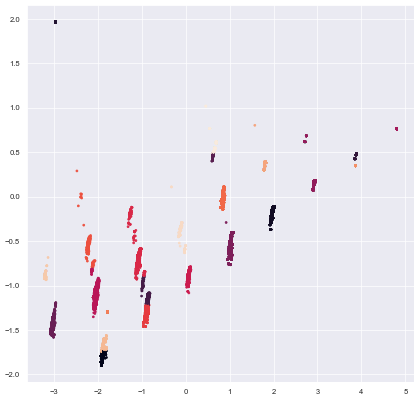

In [27]:
## PCA, Kmeans, and Visualization of clusers

import matplotlib.pyplot as plt
from matplotlib.pyplot import figure

pca = PCA(n_components = 2).fit(X)
coords = pca.transform(X)

otp_clust = 23

kmeans = KMeans(n_clusters = otp_clust, random_state=1).fit(X)
kmean_clusters = kmeans.fit_predict(coords)

figure(figsize=(10, 10), dpi=50)
plt.scatter(coords[:, 0], coords[:, 1], s = 8, c = kmean_clusters)
plt.show()